In [1]:
# Imports 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

In [2]:
# Load the data
df = pd.read_csv("Resources/pnw_final.csv")
df.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,depthError,magError,magNst,status,locationSource,magSource,year,month,day,hour
0,2025-05-20 09:29:32.099000+00:00,41.911500,-119.579000,12.80,2.70,ml,6.0,130.95,0.3520,0.1093,...,4.00,0.390,6.0,reviewed,nn,nn,2025,5,20,9
1,2025-05-19 03:03:05.700000+00:00,40.371334,-125.101166,0.33,2.74,md,22.0,271.00,0.5858,0.3200,...,13.38,0.110,15.0,automatic,nc,nc,2025,5,19,3
2,2025-05-17 05:51:18.640000+00:00,40.274167,-124.626500,5.63,3.50,mw,83.0,245.00,0.2177,0.2300,...,0.68,0.120,6.0,reviewed,nc,nc,2025,5,17,5
3,2025-05-17 05:21:49.130000+00:00,40.300335,-124.510498,5.88,2.93,md,24.0,273.00,0.1290,0.3000,...,1.75,0.080,26.0,automatic,nc,nc,2025,5,17,5
4,2025-05-17 05:06:00.660000+00:00,40.294167,-124.574165,8.36,2.95,ml,26.0,278.00,0.1772,0.1500,...,1.30,0.152,4.0,automatic,nc,nc,2025,5,17,5


In [3]:
# Set visual style
sns.set(style="whitegrid")

### Earthquakes Per Year 

C:\Users\sofon\AppData\Local\Temp\ipykernel_40456\656252478.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='year', data=df, palette='viridis')


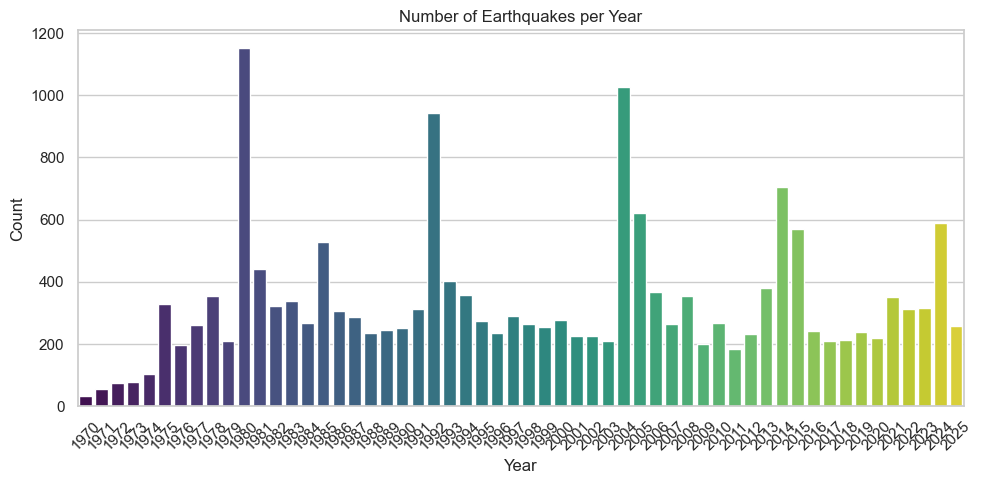

In [4]:
plt.figure(figsize=(10, 5))
sns.countplot(x='year', data=df, palette='viridis')
plt.title("Number of Earthquakes per Year")
plt.xticks(rotation=45)
plt.xlabel("Year")
plt.ylabel("Count")
plt.tight_layout()
plt.show()

### Magnitude Distribution

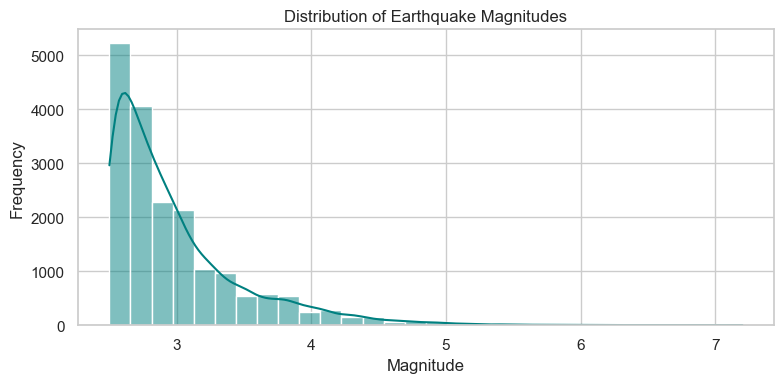

In [5]:
plt.figure(figsize=(8, 4))
sns.histplot(df['mag'], bins=30, kde=True, color='teal')
plt.title("Distribution of Earthquake Magnitudes")
plt.xlabel("Magnitude")
plt.ylabel("Frequency")
plt.tight_layout()
plt.show()

### Depth Distribution

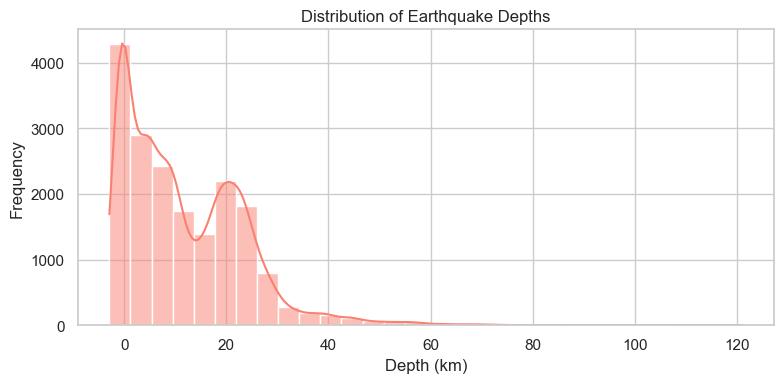

In [6]:
plt.figure(figsize=(8, 4))
sns.histplot(df['depth'], bins=30, kde=True, color='salmon')
plt.title("Distribution of Earthquake Depths")
plt.xlabel("Depth (km)")
plt.ylabel("Frequency")
plt.tight_layout()
plt.show()

### Correlation Heatmap

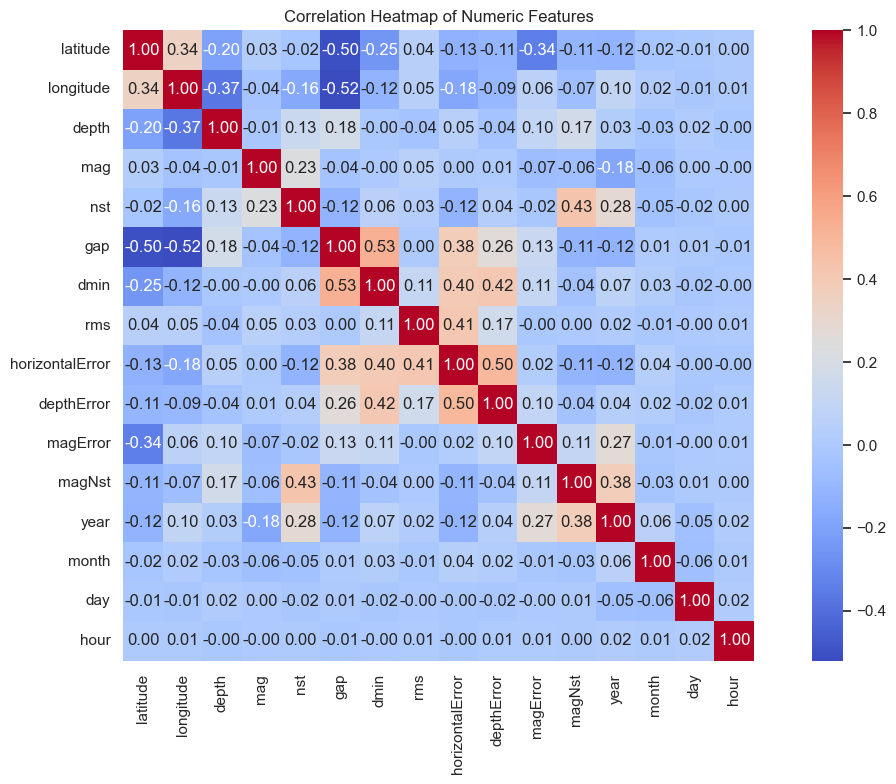

In [7]:
plt.figure(figsize=(12, 8))
corr = df.select_dtypes(include=[np.number]).corr()
sns.heatmap(corr, annot=True, fmt=".2f", cmap="coolwarm", square=True)
plt.title("Correlation Heatmap of Numeric Features")
plt.tight_layout()
plt.show()

### Scatter of Epicenters 

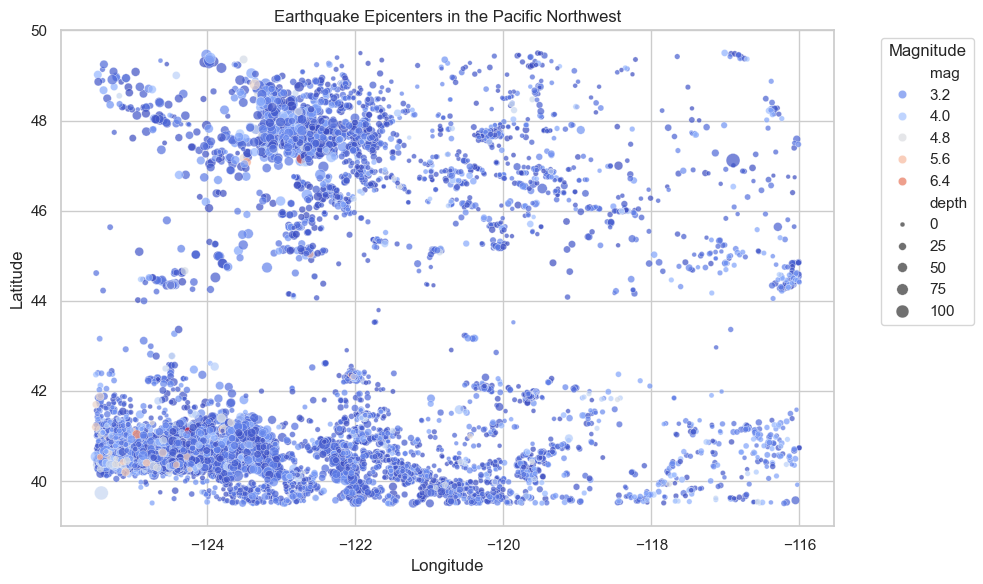

In [8]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='longitude', y='latitude', hue='mag', size='depth',
                data=df, palette='coolwarm', sizes=(10, 100), alpha=0.7)
plt.title("Earthquake Epicenters in the Pacific Northwest")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.legend(title="Magnitude", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

In [9]:
import folium
from folium.plugins import MarkerCluster

# Center map on the mean location
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=6)

# Add a marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Loop over rows to add markers
for _, row in df.iterrows():
    popup = f"<b>Location:</b> {row['place']}<br><b>Mag:</b> {row['mag']}<br><b>Depth:</b> {row['depth']} km"
    folium.CircleMarker(
        location=(row['latitude'], row['longitude']),
        radius=3 + row['mag'],  # Size scales with magnitude
        color='red' if row['mag'] >= 4 else 'blue',
        fill=True,
        fill_opacity=0.6,
        popup=popup
    ).add_to(marker_cluster)

# Save and display
m.save("pnw_quakes_map.html")
m